## B.1: Harris Corner Detection

In [3]:
import numpy as np
from PIL import Image, ImageOps
from harris import get_harris_corners
import matplotlib.pyplot as plt
from skimage.color import rgb2gray


/Users/zanemogannam/Desktop/classes/180/zanemo109.github.io/venv/lib/python3.13/site-packages/skimage/color/colorconv.py:984: RuntimeWarning: divide by zero encountered in matmul
  return rgb @ coeffs
/Users/zanemogannam/Desktop/classes/180/zanemo109.github.io/venv/lib/python3.13/site-packages/skimage/color/colorconv.py:984: RuntimeWarning: overflow encountered in matmul
  return rgb @ coeffs
/Users/zanemogannam/Desktop/classes/180/zanemo109.github.io/venv/lib/python3.13/site-packages/skimage/color/colorconv.py:984: RuntimeWarning: invalid value encountered in matmul
  return rgb @ coeffs


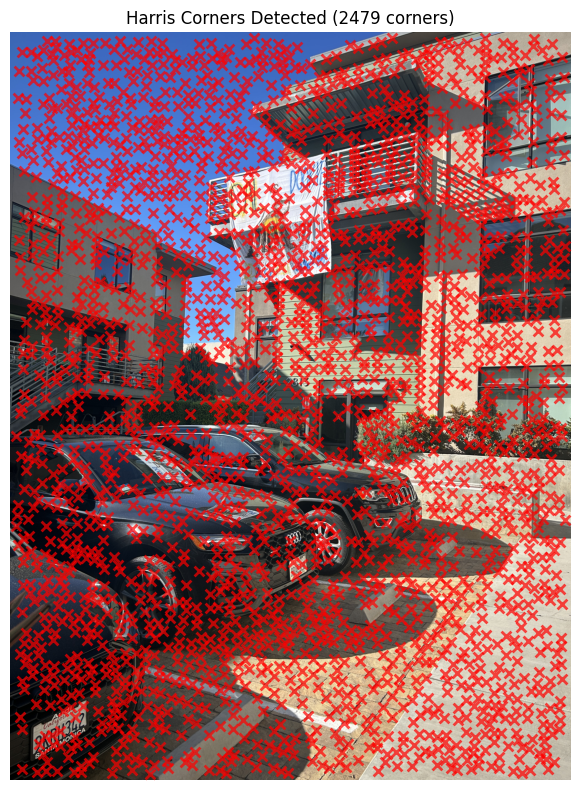

In [4]:
img1 = Image.open('../images/set1/3.JPG')
img1 = ImageOps.exif_transpose(img1) 
img1_gray = rgb2gray(np.array(img1))
img1_color = np.array(img1)


h, coords = get_harris_corners(img1_gray)

plt.figure(figsize=(12, 8))
plt.imshow(img1_color)
plt.scatter(coords[1], coords[0], c='red', marker='x', s=50, linewidths=2, alpha=0.7)
plt.title(f'Harris Corners Detected ({coords.shape[1]} corners)')
plt.axis('off')
plt.tight_layout()
# plt.savefig('../website_data_3b/harris_corners_no_anms.png')
plt.show()

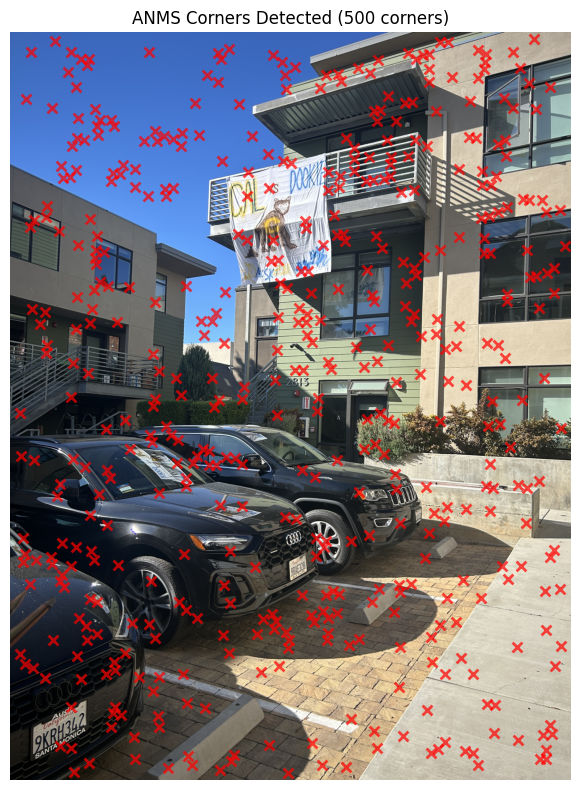

In [5]:
def anms(coords, h, num_corners=500, c_robust=0.9):
    n = coords.shape[1]
    corner_strenghts = h[coords[0], coords[1]]
    suppression_radii = np.full(n, np.inf)

    for i in range(n):
        xi = coords[:, i]
        fi = corner_strenghts[i]

        for j in range(n):
            if i == j:
                continue
            xj = coords[:, j]
            fj = corner_strenghts[j]

            if fi < c_robust * fj:
                dist = np.linalg.norm(xi - xj)

                if dist < suppression_radii[i]:
                    suppression_radii[i] = dist
    
    sorted_indices = np.argsort(suppression_radii)
    selected_indices = sorted_indices[:num_corners]
    selected_coords = coords[:, selected_indices]

    return selected_coords, suppression_radii[selected_indices]

coords_anms, radii = anms(coords, h)

plt.figure(figsize=(12, 8))
plt.imshow(img1_color)
plt.scatter(coords_anms[1], coords_anms[0], c='red', marker='x', s=50, linewidths=2, alpha=0.7)
plt.title(f'ANMS Corners Detected ({coords_anms.shape[1]} corners)')
plt.axis('off')
plt.tight_layout()
# plt.savefig('../website_data_3b/harris_corners_anms.png')
plt.show()


## B.2: Feature Extraction

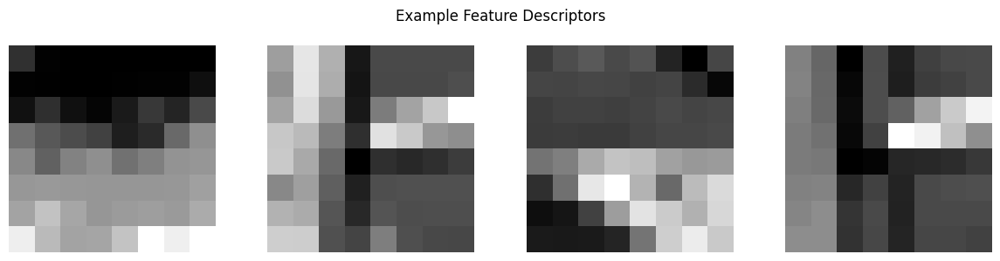

In [6]:
from skimage.transform import resize

def extract_feature_descriptors(img_gray, coords, window_size=40, descriptor_size=8):
    n = coords.shape[1]
    descriptors = []
    valid_coords = []

    half_window = window_size // 2
    h, w = img_gray.shape

    for i in range(n):
        y, x = int(coords[0, i]), int(coords[1, i])

        if (y - half_window < 0 or y + half_window >= h or 
            x - half_window < 0 or x + half_window >= w):
            continue

        window = img_gray[y - half_window:y + half_window + 1, 
                         x - half_window:x + half_window + 1]
        
        descriptor_patch = resize(window, (descriptor_size, descriptor_size), anti_aliasing=True)

        descriptor = descriptor_patch.flatten()

        descriptor = (descriptor - descriptor.mean()) / (descriptor.std() + 1e-8)
        descriptors.append(descriptor)
        valid_coords.append([y, x])

    return np.array(descriptors), np.array(valid_coords).T

descriptors, valid_coords = extract_feature_descriptors(img1_gray, coords_anms)

n_examples = 4

fig, axes = plt.subplots(1, 4, figsize=(12, 3))

for i in range(n_examples):
    descriptor_patch = descriptors[i].reshape(8, 8)
    axes[i].imshow(descriptor_patch, cmap='gray')
    axes[i].axis('off')

plt.suptitle('Example Feature Descriptors')
# plt.savefig('../website_data_3b/feature_descriptors.png')
plt.tight_layout()
plt.show()

## B.3: Feature Matching

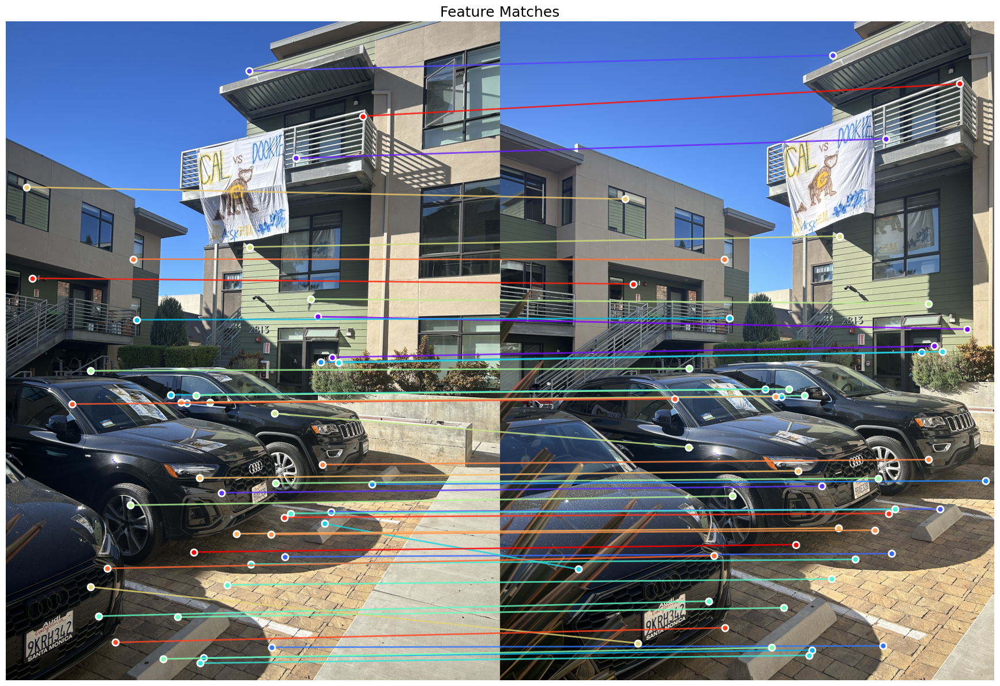

In [7]:
def match_features(descriptors_1, descriptors_2, threshold=0.8):
    matches = []

    for i in range(len(descriptors_1)):
        distances = np.linalg.norm(descriptors_2 - descriptors_1[i], axis=1)

        sorted_indices = np.argsort(distances)
        nearest_idx = sorted_indices[0]
        second_nearest_idx = sorted_indices[1]

        dist_nearest = distances[nearest_idx]
        dist_second_nearest = distances[second_nearest_idx]

        if (dist_nearest / dist_second_nearest) < threshold:
            matches.append((i, nearest_idx))

    return matches

img2 = Image.open('../images/set1/2.JPG')
img2 = ImageOps.exif_transpose(img2)
img2_gray = rgb2gray(np.array(img2))
img2_color = np.array(img2)

h2, coords2 = get_harris_corners(img2_gray)
coords2_anms, radii2 = anms(coords2, h2)
descriptors2, valid_coords2 = extract_feature_descriptors(img2_gray, coords2_anms)

matches = match_features(descriptors, descriptors2, threshold=0.6)

h1, w1 = img1_color.shape[:2]
h2, w2 = img2_color.shape[:2]
h = max(h1, h2)

combined = np.zeros((h, w1 + w2, 3), dtype=np.uint8)
combined[:h1, :w1] = img1_color
combined[:h2, w1:w1+w2] = img2_color

fig, ax = plt.subplots(figsize=(24, 12))
ax.imshow(combined)

colors = plt.cm.rainbow(np.linspace(0, 1, len(matches)))

for i, (idx1, idx2) in enumerate(matches):
    y1, x1 = coords_anms[0, idx1], coords_anms[1, idx1]
    y2, x2 = coords2_anms[0, idx2], coords2_anms[1, idx2]
    
    color = colors[i]
    
    ax.plot([x1, x2 + w1], [y1, y2], color=color, linewidth=2, alpha=0.8)
    
    ax.plot(x1, y1, 'o', color=color, markersize=8, markeredgecolor='white', markeredgewidth=2)
    ax.plot(x2 + w1, y2, 'o', color=color, markersize=8, markeredgecolor='white', markeredgewidth=2)

ax.set_title(f'Feature Matches', fontsize=18)
ax.axis('off')
plt.tight_layout()
# plt.savefig('../website_data_3b/feature_matches.png', dpi=150, bbox_inches='tight')
plt.show()



## B.4: RANSAC and Mosaics

In [8]:
# code from 3a
def computeH(im1_pts, im2_pts):
    'Compute homography matrix such that im2_pts = H @ im1_pts'
    n = im1_pts.shape[0]

    A = []
    b = []

    for i in range(n):
        x, y = im1_pts[i]
        x_prime, y_prime = im2_pts[i]

        A.append([x, y, 1, 0, 0, 0, -x*x_prime, -y*x_prime])
        b.append(x_prime)

        A.append([0, 0, 0, x, y, 1, -x*y_prime, -y*y_prime])
        b.append(y_prime)

    A = np.array(A)
    b = np.array(b)

    h, _, _, _ = np.linalg.lstsq(A, b, rcond=None)

    H = np.array([
        [h[0], h[1], h[2]],
        [h[3], h[4], h[5]],
        [h[6], h[7], 1]
    ])
    print(f'System of equations: {A} @ h = {b}')
    print(f'Solution: h = {h}')
    print(f'Recovered H: {H}')
    return H

def get_output_bounds(im_shape, H):
    h, w = im_shape[:2]
    corners = np.array([
        [0, 0, 1],
        [w - 1, 0, 1],
        [0, h - 1, 1],
        [w - 1, h - 1, 1]
    ]).T

    warped_corners = H @ corners
    warped_corners = warped_corners[:2, :] / warped_corners[2, :]

    x_min, x_max = warped_corners[0, :].min(), warped_corners[0, :].max()
    y_min, y_max = warped_corners[1, :].min(), warped_corners[1, :].max()

    return x_min, x_max, y_min, y_max

def compute_mosaic_bounds(images, homographies, ref_idx):
    all_corners = []
    
    for i, img in enumerate(images):
        h, w = img.shape[:2]
        corners = np.array([
            [0, 0, 1],
            [w - 1, 0, 1],
            [0, h - 1, 1],
            [w - 1, h - 1, 1]
        ]).T
        
        if i == ref_idx:
            warped_corners = corners
        else:
            warped_corners = homographies[i] @ corners
            warped_corners = warped_corners[:2, :] / warped_corners[2, :]
        
        all_corners.append(warped_corners.T[:, :2])
    
    all_corners = np.vstack(all_corners)
    x_min, y_min = all_corners.min(axis=0)
    x_max, y_max = all_corners.max(axis=0)
    
    return x_min, x_max, y_min, y_max

def create_alpha_mask(shape, blend_width=100):
    """Create alpha mask with linear falloff from edges"""
    h, w = shape[:2]
    alpha = np.ones((h, w), dtype=np.float32)
    
    for y in range(h):
        for x in range(w):
            dist_to_edge = min(x, w - 1 - x, y, h - 1 - y)
            if dist_to_edge < blend_width:
                alpha[y, x] = dist_to_edge / blend_width
    
    return alpha

def warp_image_nearest_neighbor(im, H, fixed_output_shape=None):
    h_in, w_in, channels = im.shape

    if fixed_output_shape is not None:
        w_out, h_out = fixed_output_shape
        x_min, y_min = 0, 0
    else:
        x_min, x_max, y_min, y_max = get_output_bounds(im.shape, H)
        w_out = int(np.ceil(x_max - x_min))
        h_out = int(np.ceil(y_max - y_min))

    warped_im = np.zeros((h_out, w_out, channels), dtype=im.dtype)
    alpha_mask = np.zeros((h_out, w_out), dtype=np.float32)

    H_inv = np.linalg.inv(H)

    x_out, y_out = np.meshgrid(np.arange(w_out), np.arange(h_out))
    x_out = x_out + x_min
    y_out = y_out + y_min

    output_coords = np.stack([x_out.ravel(), y_out.ravel(), np.ones(h_out * w_out)])

    coords_in = H_inv @ output_coords
    coords_in = coords_in[:2, :] / coords_in[2, :]

    x_in = coords_in[0, :].reshape(h_out, w_out)
    y_in = coords_in[1, :].reshape(h_out, w_out)

    x_in_nearest_neighbor = np.round(x_in).astype(int)
    y_in_nearest_neighbor = np.round(y_in).astype(int)

    valid = (x_in_nearest_neighbor >= 0) & (x_in_nearest_neighbor < w_in) & (y_in_nearest_neighbor >= 0) & (y_in_nearest_neighbor < h_in)

    y_valid, x_valid = np.where(valid)

    warped_im[y_valid, x_valid, :] = im[y_in_nearest_neighbor[valid], x_in_nearest_neighbor[valid], :]
    alpha_mask[valid] = True

    return warped_im, alpha_mask

def create_mosaic(images, homographies, ref_idx, blend_width=100):
    x_min, x_max, y_min, y_max = compute_mosaic_bounds(images, homographies, ref_idx)
    
    w_out = int(np.ceil(x_max - x_min))
    h_out = int(np.ceil(y_max - y_min))
    
    mosaic_sum = np.zeros((h_out, w_out, 3), dtype=np.float64)
    weight_sum = np.zeros((h_out, w_out), dtype=np.float64)
    
    for i, img in enumerate(images):
        
        alpha_base = create_alpha_mask(img.shape, blend_width)
        
        T_offset = np.array([
            [1, 0, -x_min],
            [0, 1, -y_min],
            [0, 0, 1]
        ])
        
        if i == ref_idx:
            H_adjusted = T_offset
        else:
            H_adjusted = T_offset @ homographies[i]
        
        warped_img, warped_mask = warp_image_nearest_neighbor(img, H_adjusted, 
                                                       fixed_output_shape=(w_out, h_out))
        
        alpha_img = np.stack([alpha_base] * 3, axis=2).astype(img.dtype)
        warped_alpha, _ = warp_image_nearest_neighbor(alpha_img, H_adjusted,
                                               fixed_output_shape=(w_out, h_out))
        warped_alpha = warped_alpha[:, :, 0] * warped_mask
        
        mosaic_sum += warped_img.astype(np.float64) * warped_alpha[:, :, np.newaxis]
        weight_sum += warped_alpha
    
    weight_sum[weight_sum == 0] = 1
    mosaic = mosaic_sum / weight_sum[:, :, np.newaxis]
    mosaic = np.clip(mosaic, 0, 255).astype(np.uint8)
    
    return mosaic

System of equations: [[      405      2341         1         0         0         0   -433350
   -2504870]
 [        0         0         0       405      2341         1   -935145
   -5405369]
 [      619      3347         1         0         0         0   -809033
   -4374529]
 [        0         0         0       619      3347         1  -2023511
  -10941343]
 [      568      3639         1         0         0         0   -725336
   -4647003]
 [        0         0         0       568      3639         1  -2014696
  -12907533]
 [     1488       303         1         0         0         0  -3028080
    -616605]
 [        0         0         0      1488       303         1   -306528
     -62418]] @ h = [1070 2309 1307 3269 1277 3547 2035  206]
Solution: h = [ 2.38115199e-01 -3.37977521e-02  7.78124366e+02 -6.35628328e-01
  4.48739918e-01  9.23445286e+02 -2.89317826e-04 -5.95574363e-05]
Recovered H: [[ 2.38115199e-01 -3.37977521e-02  7.78124366e+02]
 [-6.35628328e-01  4.48739918e-01  9.2344

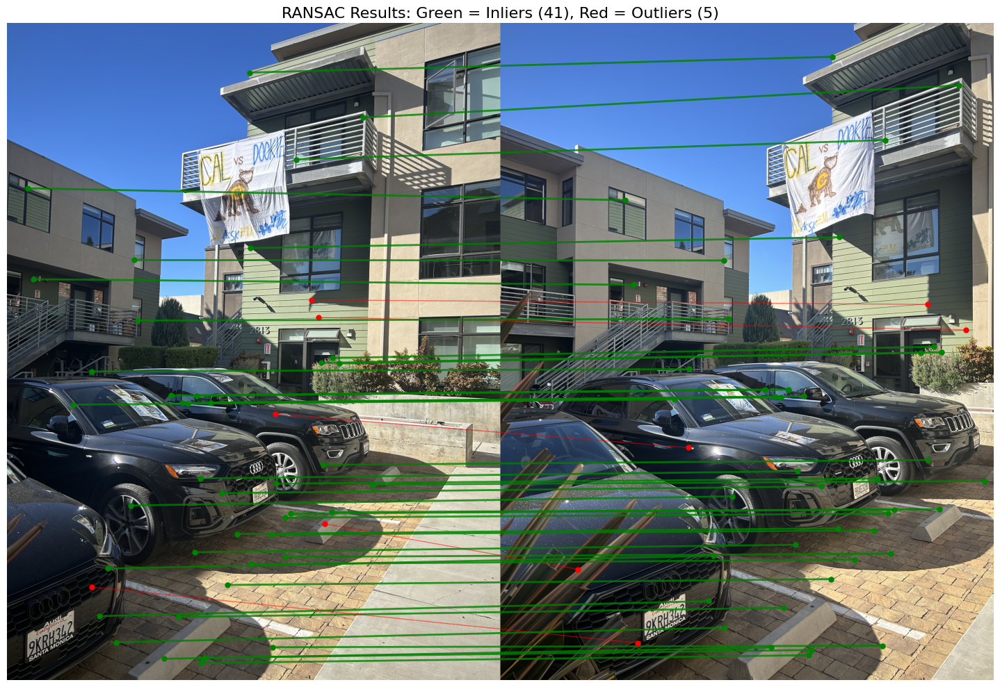

In [9]:
def apply_homography(H, pts):
    pts_homogenous = np.hstack([pts, np.ones((pts.shape[0], 1))])
    transformed = H @ pts_homogenous.T
    transformed_pts = transformed[:, :2] / transformed[:, 2:3]

    return transformed_pts

def ransac_homography(coords1, coords2, matches, threshold=15, num_iter=5000):
    pts1 = np.array([[coords1[1, i], coords1[0, i]] for i, _ in matches])
    pts2 = np.array([[coords2[1, j], coords2[0, j]] for _, j in matches])

    best_H = None
    best_mask = None
    best_inliers = 0

    for _ in range(num_iter):
        idx = np.random.choice(len(matches), 4, replace=False)
        H = computeH(pts1[idx], pts2[idx])

        pts_1_homography = np.hstack([pts1, np.ones((pts1.shape[0], 1))])
        pts_1_transformed = H @ pts_1_homography.T
        pts_1_transformed = pts_1_transformed[:2, :] / pts_1_transformed[2, :]

        dists = np.linalg.norm(pts2 - pts_1_transformed.T, axis=1)
        inlier_mask = dists < threshold

        if np.sum(inlier_mask) > best_inliers:
            best_inliers = np.sum(inlier_mask)
            best_mask = inlier_mask
            best_H = H

    if best_inliers >= 4:
        best_H = computeH(pts1[best_mask], pts2[best_mask])

    print(f"RANSAC: {best_inliers} inliers / {len(matches)} matches")
    return best_H, best_mask

H, inlier_mask = ransac_homography(coords_anms, coords2_anms, matches)

h1, w1 = img1_color.shape[:2]
h2, w2 = img2_color.shape[:2]
h = max(h1, h2)

combined = np.zeros((h, w1 + w2, 3), dtype=np.uint8)
combined[:h1, :w1] = img1_color
combined[:h2, w1:w1+w2] = img2_color

fig, ax = plt.subplots(figsize=(20, 10))
ax.imshow(combined)

for i, (idx1, idx2) in enumerate(matches):
    y1, x1 = coords_anms[0, idx1], coords_anms[1, idx1]
    y2, x2 = coords2_anms[0, idx2], coords2_anms[1, idx2]
    
    if inlier_mask[i]:
        ax.plot([x1, x2 + w1], [y1, y2], 'g-', linewidth=2, alpha=0.8)
        ax.plot(x1, y1, 'go', markersize=5)
        ax.plot(x2 + w1, y2, 'go', markersize=5)
    else:
        ax.plot([x1, x2 + w1], [y1, y2], 'r-', linewidth=1, alpha=0.5)
        ax.plot(x1, y1, 'ro', markersize=5)
        ax.plot(x2 + w1, y2, 'ro', markersize=5)

ax.set_title(f'RANSAC Results: Green = Inliers ({np.sum(inlier_mask)}), Red = Outliers ({len(matches) - np.sum(inlier_mask)})', 
             fontsize=16)
ax.axis('off')
plt.tight_layout()
# plt.savefig('../website_data_3b/ransac_inliers.png', dpi=150, bbox_inches='tight')
plt.show()  


/Users/zanemogannam/Desktop/classes/180/zanemo109.github.io/venv/lib/python3.13/site-packages/skimage/color/colorconv.py:984: RuntimeWarning: divide by zero encountered in matmul
  return rgb @ coeffs
/Users/zanemogannam/Desktop/classes/180/zanemo109.github.io/venv/lib/python3.13/site-packages/skimage/color/colorconv.py:984: RuntimeWarning: overflow encountered in matmul
  return rgb @ coeffs
/Users/zanemogannam/Desktop/classes/180/zanemo109.github.io/venv/lib/python3.13/site-packages/skimage/color/colorconv.py:984: RuntimeWarning: invalid value encountered in matmul
  return rgb @ coeffs


System of equations: [[    1624     2298        1        0        0        0 -1908200 -2700150]
 [       0        0        0     1624     2298        1 -3740072 -5292294]
 [    1122     2598        1        0        0        0  -745008 -1725072]
 [       0        0        0     1122     2598        1 -2966568 -6869112]
 [    1340     2440        1        0        0        0 -1195280 -2176480]
 [       0        0        0     1340     2440        1 -3304440 -6017040]
 [    2324      582        1        0        0        0  -553112  -138516]
 [       0        0        0     2324      582        1 -2700488  -676284]] @ h = [1175 2303  664 2644  892 2466  238 1162]
Solution: h = [-1.24346538e+00 -8.37377394e-01  3.30283703e+03 -9.10613075e-01
 -8.91944861e-01  2.27247071e+03 -4.81475469e-04 -3.32238023e-04]
Recovered H: [[-1.24346538e+00 -8.37377394e-01  3.30283703e+03]
 [-9.10613075e-01 -8.91944861e-01  2.27247071e+03]
 [-4.81475469e-04 -3.32238023e-04  1.00000000e+00]]
System of equation

/var/folders/nc/dkzh6vs93fq3m59dzmkbrq1h0000gn/T/ipykernel_6543/4217753630.py:32: RuntimeWarning: divide by zero encountered in matmul
  coords_in = H_inv @ output_coords
/var/folders/nc/dkzh6vs93fq3m59dzmkbrq1h0000gn/T/ipykernel_6543/4217753630.py:32: RuntimeWarning: overflow encountered in matmul
  coords_in = H_inv @ output_coords
/var/folders/nc/dkzh6vs93fq3m59dzmkbrq1h0000gn/T/ipykernel_6543/4217753630.py:32: RuntimeWarning: invalid value encountered in matmul
  coords_in = H_inv @ output_coords


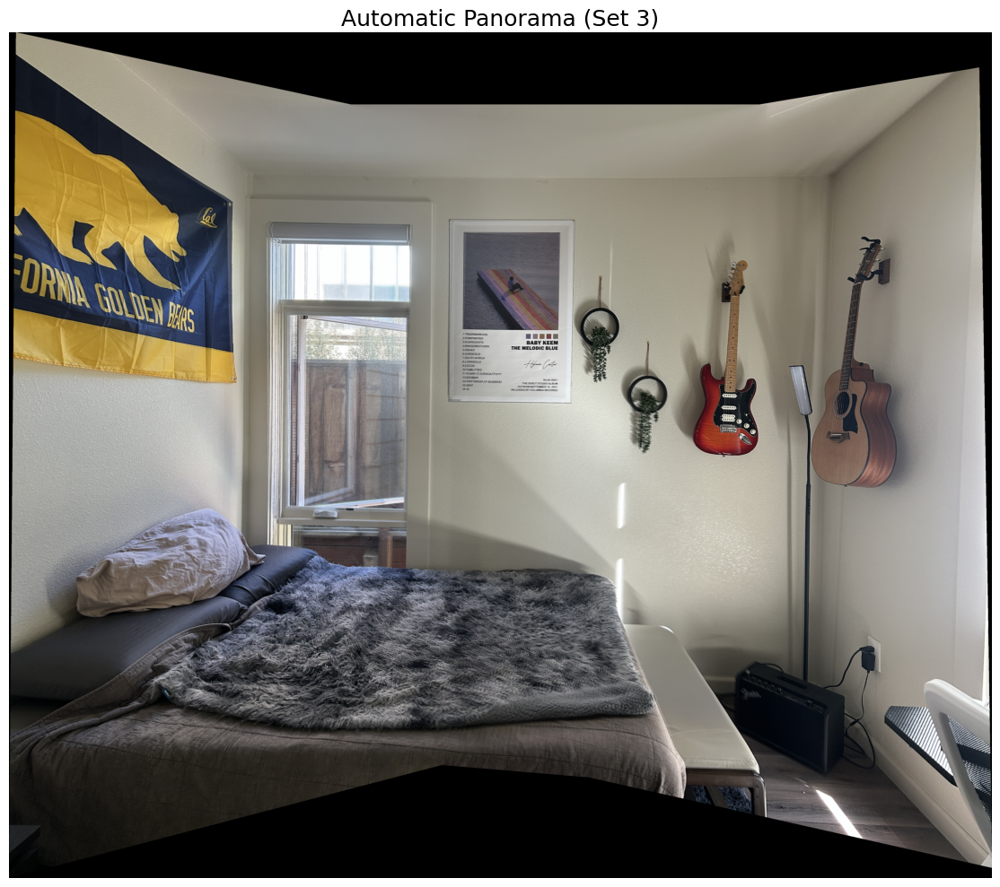

In [29]:
from scipy.ndimage import distance_transform_edt

def get_output_bounds(im_shape, H):
    h, w = im_shape[:2]
    corners = np.array([[0, 0, 1], [w-1, 0, 1], [0, h-1, 1], [w-1, h-1, 1]]).T
    warped = H @ corners
    warped = warped[:2, :] / warped[2, :]
    return warped[0].min(), warped[0].max(), warped[1].min(), warped[1].max()

def warp_image_nearest_neighbor(im, H, fixed_output_shape=None):
    h_in, w_in, channels = im.shape

    if fixed_output_shape is not None:
        w_out, h_out = fixed_output_shape
        x_min, y_min = 0, 0
    else:
        x_min, x_max, y_min, y_max = get_output_bounds(im.shape, H)
        w_out = int(np.ceil(x_max - x_min))
        h_out = int(np.ceil(y_max - y_min))

    warped_im = np.zeros((h_out, w_out, channels), dtype=im.dtype)
    alpha_mask = np.zeros((h_out, w_out), dtype=np.float32)

    H_inv = np.linalg.inv(H)

    x_out, y_out = np.meshgrid(np.arange(w_out), np.arange(h_out))
    x_out = x_out + x_min
    y_out = y_out + y_min

    output_coords = np.stack([x_out.ravel(), y_out.ravel(), np.ones(h_out * w_out)])

    coords_in = H_inv @ output_coords
    coords_in = coords_in[:2, :] / coords_in[2, :]

    x_in = coords_in[0, :].reshape(h_out, w_out)
    y_in = coords_in[1, :].reshape(h_out, w_out)

    x_in_nearest_neighbor = np.round(x_in).astype(int)
    y_in_nearest_neighbor = np.round(y_in).astype(int)

    valid = (x_in_nearest_neighbor >= 0) & (x_in_nearest_neighbor < w_in) & (y_in_nearest_neighbor >= 0) & (y_in_nearest_neighbor < h_in)

    y_valid, x_valid = np.where(valid)

    warped_im[y_valid, x_valid, :] = im[y_in_nearest_neighbor[valid], x_in_nearest_neighbor[valid], :]
    alpha_mask[valid] = True

    return warped_im, alpha_mask

def create_panorama_reference_frame(set_path, resize_factor=0.4):
    images = []
    for i in range(1, 6):
        img = Image.open(f'{set_path}/{i}.JPG')
        img = ImageOps.exif_transpose(img)
        new_size = (int(img.size[0]*resize_factor), int(img.size[1]*resize_factor))
        img = img.resize(new_size, Image.LANCZOS)
        images.append(np.array(img))

    n = 5
    ref_idx = n // 2 
    
    all_desc = []
    all_coords = []
    
    for i, img in enumerate(images):
        img_gray = rgb2gray(img)
        h, coords = get_harris_corners(img_gray)
        coords_anms, _ = anms(coords, h, num_corners=500)
        desc, coords_valid = extract_feature_descriptors(img_gray, coords_anms)
        all_desc.append(desc)
        all_coords.append(coords_valid)
    
    H_to_ref = [None] * n
    H_to_ref[ref_idx] = np.eye(3)
    
    for i in range(n):
        if i == ref_idx:
            continue
        
        if i < ref_idx:
            H_accum = np.eye(3)
            for j in range(i, ref_idx):
                matches = match_features(all_desc[j], all_desc[j+1], threshold=0.75)
                H, inliers = ransac_homography(all_coords[j], all_coords[j+1], matches,
                                              threshold=5, num_iter=3000)
                H_accum = H @ H_accum
            H_to_ref[i] = H_accum
        else:
            H_accum = np.eye(3)
            for j in range(i, ref_idx, -1):
                matches = match_features(all_desc[j-1], all_desc[j], threshold=0.75)
                H, inliers = ransac_homography(all_coords[j-1], all_coords[j], matches,
                                              threshold=5, num_iter=3000)
                H_accum = np.linalg.inv(H) @ H_accum
            H_to_ref[i] = H_accum
    
    x_min, x_max = 0, images[ref_idx].shape[1]
    y_min, y_max = 0, images[ref_idx].shape[0]
    
    for i, H in enumerate(H_to_ref):
        if i == ref_idx:
            continue
        xmin, xmax, ymin, ymax = get_output_bounds(images[i].shape, H)
        x_min = min(x_min, xmin)
        x_max = max(x_max, xmax)
        y_min = min(y_min, ymin)
        y_max = max(y_max, ymax)
    
    w_out = int(np.ceil(x_max - x_min))
    h_out = int(np.ceil(y_max - y_min))
    
    
    T = np.array([[1, 0, -x_min], [0, 1, -y_min], [0, 0, 1]])
    
    all_warped = []
    all_masks = []
    
    for i in range(n):
        H_adjusted = T @ H_to_ref[i]
        warped, mask = warp_image_nearest_neighbor(images[i], H_adjusted, (w_out, h_out))
        all_warped.append(warped)
        all_masks.append(mask)
    
    all_dists = [distance_transform_edt(mask) for mask in all_masks]
    
    result = np.zeros((h_out, w_out, 3), dtype=np.float32)
    weight_sum = np.zeros((h_out, w_out), dtype=np.float32)
    
    for i in range(n):
        weight = all_dists[i]
        result += all_warped[i].astype(np.float32) * weight[:, :, np.newaxis]
        weight_sum += weight
    
    weight_sum[weight_sum == 0] = 1
    result = result / weight_sum[:, :, np.newaxis]
    
    return np.clip(result, 0, 255).astype(np.uint8)

mosaic_set1 = create_panorama_reference_frame('../images/set3/', resize_factor=0.8)

plt.figure(figsize=(24, 10))
plt.imshow(mosaic_set1)
plt.title('Automatic Panorama (Set 3)', fontsize=18)
plt.axis('off')
plt.tight_layout()
plt.savefig('../website_data_3b/mosaic_set3_auto.png', dpi=150, bbox_inches='tight')
plt.show()